# Feature Extraction

Transfer Learning is leveraging a working models existing architecture and learned patterns for our own problems. There are 2 main benefits:

1. Can leverage an existing neural network architecture proven to works on a problem similar to our own
2. Can leverage a working neural network architecture which has already learned patterns on similar data to our own, then we can adapt those patterns to our own data

In [ ]:
!nvidia-smi

Sat May 13 11:23:20 2023       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 525.85.12    Driver Version: 525.85.12    CUDA Version: 12.0     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla T4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   35C    P8    10W /  70W |      0MiB / 15360MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

## Get the data

In [ ]:
import zipfile

!wget 'https://storage.googleapis.com/ztm_tf_course/food_vision/10_food_classes_10_percent.zip'

zip_ref = zipfile.ZipFile('10_food_classes_10_percent.zip')
zip_ref.extractall()
zip_ref.close()

--2023-05-13 11:23:22--  https://storage.googleapis.com/ztm_tf_course/food_vision/10_food_classes_10_percent.zip
Resolving storage.googleapis.com (storage.googleapis.com)... 74.125.204.128, 64.233.189.128, 108.177.97.128, ...
Connecting to storage.googleapis.com (storage.googleapis.com)|74.125.204.128|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 168546183 (161M) [application/zip]
Saving to: ‘10_food_classes_10_percent.zip’

10_food_classes_10_ 100%[===================>] 160.74M  30.6MB/s    in 6.1s    

2023-05-13 11:23:28 (26.4 MB/s) - ‘10_food_classes_10_percent.zip’ saved [168546183/168546183]



## EDA

In [ ]:
!ls '10_food_classes_10_percent'

test  train


In [ ]:
!ls '10_food_classes_10_percent/train'

chicken_curry  fried_rice      hamburger  pizza  steak
chicken_wings  grilled_salmon  ice_cream  ramen  sushi


In [ ]:
!ls '10_food_classes_10_percent/test'

chicken_curry  fried_rice      hamburger  pizza  steak
chicken_wings  grilled_salmon  ice_cream  ramen  sushi


In [ ]:
import os 

# wlakt through food classes dir and list number of files
for dirpath, dirnames, filenames in os.walk('10_food_classes_10_percent'):
  print(f"there are {len(dirnames)} directories and {len(filenames)} images in '{dirpath}'.\n")

there are 2 directories and 0 images in '10_food_classes_10_percent'.

there are 10 directories and 0 images in '10_food_classes_10_percent/train'.

there are 0 directories and 75 images in '10_food_classes_10_percent/train/grilled_salmon'.

there are 0 directories and 75 images in '10_food_classes_10_percent/train/pizza'.

there are 0 directories and 75 images in '10_food_classes_10_percent/train/fried_rice'.

there are 0 directories and 75 images in '10_food_classes_10_percent/train/steak'.

there are 0 directories and 75 images in '10_food_classes_10_percent/train/ice_cream'.

there are 0 directories and 75 images in '10_food_classes_10_percent/train/chicken_curry'.

there are 0 directories and 75 images in '10_food_classes_10_percent/train/chicken_wings'.

there are 0 directories and 75 images in '10_food_classes_10_percent/train/sushi'.

there are 0 directories and 75 images in '10_food_classes_10_percent/train/hamburger'.

there are 0 directories and 75 images in '10_food_classes

Here we're using full test data from food101 dataset, while for training set we're using only 10% of original training data. This is because we're no longer need to train our model from the scratch, we're going to use transfer learning.

## Data loaders

We're going to use ImageDataGenerator for downloading images in batches

In [ ]:
from tensorflow.keras.preprocessing.image import ImageDataGenerator

train_dir = '10_food_classes_10_percent/train/'
test_dir = '10_food_classes_10_percent/test/'
BATCH_SIZE = 32
TARGET_IMG_SHAPE = (224, 224)

train_datagen = ImageDataGenerator(rescale = 1/255.)

test_datagen = ImageDataGenerator(rescale = 1/255.)

print('Training images:')
train_data = train_datagen.flow_from_directory(train_dir,
                                               batch_size = BATCH_SIZE,
                                               target_size = TARGET_IMG_SHAPE,
                                               class_mode = 'categorical'
                                               )
print('\nTesting images:')
test_data = test_datagen.flow_from_directory(test_dir,
                                             batch_size = BATCH_SIZE,
                                             target_size = TARGET_IMG_SHAPE,
                                             class_mode = 'categorical')

Training images:
Found 750 images belonging to 10 classes.

Testing images:
Found 2500 images belonging to 10 classes.


## Setting up callbacks

Callbacks are extra functionality that can be performed during or after training. Some of the most popular callbacks are:

* Tracking experiments with the TensorBoard callback
* Model checkpointing with the ModelCheckpoint callback
* Stopping a model from training before it trains too long and start to overfit with the EarlyStopping callback

To sum up callbacks are some functionalities that can be helpful while training our model.

### TensorBoard

So let's imagine that we have 5 models. Each one of them have some experiments implemented and have different outcomes, while working on a pure colab it might be exhausting for us simply to scroll through the notebook. Intead we can use TensorBoard callback to check each of the model.

In [ ]:
import datetime # to follow dates of running each model

def create_tensorboard_callback(dir_name, experiment_name):
  log_dir = dir_name + '/' + experiment_name + datetime.datetime.now().strftime('%S%M%H - %D%M%Y')
  tensorboard_callback = tf.keras.callbacks.TensorBoard(log_dir = log_dir)
  print(f'Saving TensorBoard log files to: {log_dir}')
  return tensorboard_callback

## Model from Tensorflow Hub

Previously we've created our model layer by layer. Now we're going to do similar thing, but most of our layers will come from Tensorflow Hub. Tensorflow Hub is a repository with pretrained models. So all we need to do is importing specific model and used it's layers for our predictions. There are some additional things that will be covered later.

We can access models in https://tfhub.dev

Tensorflow Hub is a great resource, however while we have multiple models for same problem it's useful to visit https://paperswithcode.com. Here we will find all documentation and code for deep learning issues and also can see which model performs better in specific deep learning problem.

Browsing Tensorflow Hub we found 2 models for image classification: 
* Efficientnet - https://tfhub.dev/tensorflow/efficientnet/b0/feature-vector/1  
* Resnet - https://tfhub.dev/google/imagenet/resnet_v2_50/classification/5

Now let's compare it!

### Model urls

In [ ]:
efficientnet_url = 'https://tfhub.dev/tensorflow/efficientnet/b0/feature-vector/1'

resnet_url = 'https://tfhub.dev/google/imagenet/resnet_v2_50/classification/5'

### Import dependencies

In [ ]:
import tensorflow as tf
import tensorflow_hub as hub
from tensorflow.keras import layers

### Class names

In [ ]:
import pathlib
import numpy as np
data_dir = pathlib.Path('10_food_classes_10_percent/train')
class_names = np.array(sorted([item.name for item in data_dir.glob('*')])) # created a list of class_names from the subdirectory
class_names

array(['chicken_curry', 'chicken_wings', 'fried_rice', 'grilled_salmon',
       'hamburger', 'ice_cream', 'pizza', 'ramen', 'steak', 'sushi'],
      dtype='<U14')

### Functions: load_and_prep / prep_and_plot

In [ ]:
import matplotlib.pyplot as plt


def load_and_prep_image(filename, img_shape = 224):
  """
  Reads an image from an output and turns it into tensor and reshapes it
  to (img_shape, img_shape, colour_channels)
  """

  # Read in the image
  img = tf.io.read_file(filename)
  # Decode the read file into image
  img = tf.image.decode_image(img)
  # Changes shape of image tensor into desired shape
  img = tf.image.resize(img, size = [img_shape, img_shape])
  # Rescaling
  img = img / 255.

  return img

def pred_and_plot(model, filename, class_names = class_names):
  """
  Imports and image located in filename, makes a prediction with model
  and plots the image with the predicted class and title
  """
  # Import the targeted image and preprocess it
  img = load_and_prep_image(filename)

  # Make a prediction
  pred = model.predict(tf.expand_dims(img, axis = 0))

  # # Get the predicted class
  if len(pred[0]) > 1:       # Binary classification uses sigmoid function whitch returns 1 number, when it comes to softmax, thus multi-class classification returns multiple probabilities, each for one class
    pred_class = class_names[tf.argmax(pred[0])]
  else:
    pred_class = class_names[int(tf.round(pred))]

  # Plot the image and predicted class
  plt.imshow(img)
  plt.title(f"Prediction: {pred_class}")
  plt.axis(False)

### Functions: plot loss accuracy curves

In [ ]:
def plot_loss_accuracy_curves(history):
  """
  Returns separate loss curves for training and validation metrics
  """

  loss = history.history['loss']
  val_loss = history.history['val_loss']

  accuracy = history.history['accuracy']
  val_accuracy = history.history['val_accuracy']

  epochs = range(len(history.history['loss']))

  # Plot loss
  plt.plot(epochs, loss, label = 'training_loss')
  plt.plot(epochs, val_loss, label = 'val_loss')
  plt.title('loss')
  plt.xlabel('epochs')
  plt.legend()

  # Plot accuracy
  plt.figure() # this will create a new  plot figure
  plt.plot(epochs, accuracy, label = 'training_accuracy')
  plt.plot(epochs, val_accuracy, label = 'loss_accuracy')
  plt.title('accuracy')
  plt.xlabel('epochs')
  plt.legend()

  plt.show()

### Create model function

In [ ]:
def create_model(model_url, num_classes = 10):
  """
  Takes a TensorFlow hub url and creates Keras Sequential model

  Args:
    model_url (str): TensorFlow Hub feature extraction model URL
    num_classes (int): Number of output neurons in the output layer. Should be equal of number target classes, default 10.

  Returns:
    An uncompiled Keras Sequential model with model_url as feature extractor layer and Dense output layer with num_classes output neurons.
  """
  TARGET_IMG_SHAPE = (224, 224)
  # Download pretrained model and save it as Keras layer
  feature_extractor_layer = hub.KerasLayer(model_url,
                                           trainable = False, # Freeze the already learned patterns
                                           name = 'feature_extraction_layer',
                                           input_shape = TARGET_IMG_SHAPE + (3,)) 


  # Create our own model
  model = tf.keras.Sequential([
      feature_extractor_layer,
      layers.Dense(num_classes, activation = 'softmax', name = 'output_layer')
  ])

  return model

For target_img_shape we are just adding 3rd dimension because of RGB colors.

In [ ]:
TARGET_IMG_SHAPE + (3,)

(224, 224, 3)

### Create and Test ResNet TensorFlow Hub feature extraction model

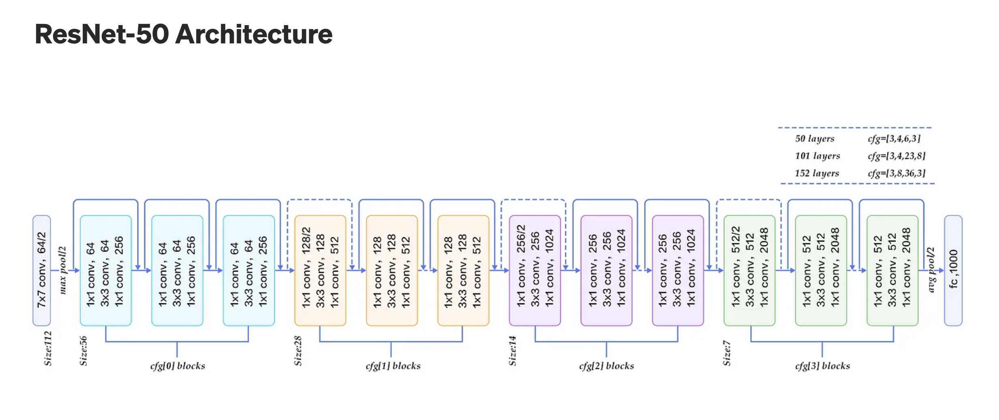

#### Model

In [ ]:
resnet_model = create_model(resnet_url, 
                            num_classes = train_data.num_classes)

In [ ]:
resnet_model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 feature_extraction_layer (K  (None, 1001)             25615849  
 erasLayer)                                                      
                                                                 
 output_layer (Dense)        (None, 10)                10020     
                                                                 
Total params: 25,625,869
Trainable params: 10,020
Non-trainable params: 25,615,849
_________________________________________________________________


#### Compile

In [ ]:
resnet_model.compile(
    optimizer = tf.keras.optimizers.Adam(),
    loss = 'categorical_crossentropy',
    metrics = ['accuracy']
)

#### Fit

In [ ]:
history_resnet = resnet_model.fit(
    train_data,
    epochs = 5,
    steps_per_epoch = len(train_data),
    validation_data = test_data,
    validation_steps = len(test_data),
    callbacks = create_tensorboard_callback('transfer_learning', 'ResNet_model_v.1.1')
)

Saving TensorBoard log files to: transfer_learning/ResNet_model_v.1.1442311 - 05/13/23232023
Epoch 1/5
24/24 [==============================] - 31s 757ms/step - loss: 2.1697 - accuracy: 0.3613 - val_loss: 1.2182 - val_accuracy: 0.5900
Epoch 2/5
24/24 [==============================] - 16s 682ms/step - loss: 0.9947 - accuracy: 0.6880 - val_loss: 0.9063 - val_accuracy: 0.7000
Epoch 3/5
24/24 [==============================] - 16s 684ms/step - loss: 0.6850 - accuracy: 0.7840 - val_loss: 0.8341 - val_accuracy: 0.7204
Epoch 4/5
24/24 [==============================] - 16s 677ms/step - loss: 0.5503 - accuracy: 0.8227 - val_loss: 0.8111 - val_accuracy: 0.7312
Epoch 5/5
24/24 [==============================] - 16s 676ms/step - loss: 0.4403 - accuracy: 0.8613 - val_loss: 0.7773 - val_accuracy: 0.7468


#### Evaluate

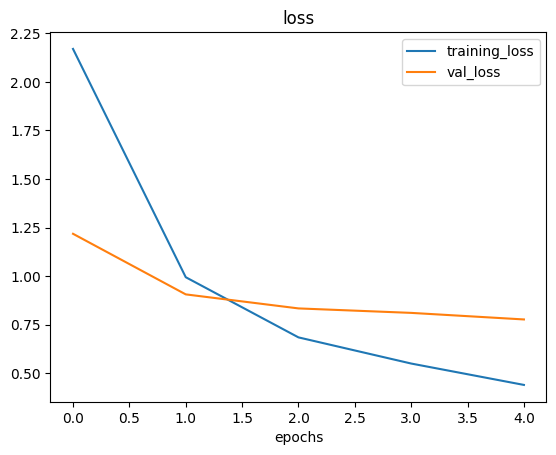

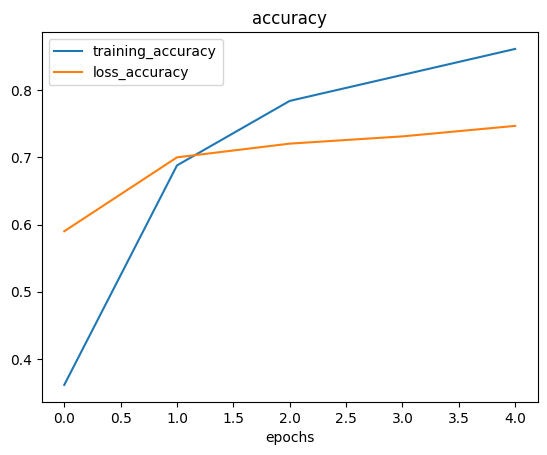

In [ ]:
import pandas as pd

plot_loss_accuracy_curves(history_resnet)

Model is overfitting, however let's use that anyways.

In [ ]:
resnet_model.evaluate(test_data)

79/79 [==============================] - 12s 155ms/step - loss: 0.7773 - accuracy: 0.7468


[0.7772688269615173, 0.7468000054359436]

#### Predict

In [ ]:
class_names

array(['chicken_curry', 'chicken_wings', 'fried_rice', 'grilled_salmon',
       'hamburger', 'ice_cream', 'pizza', 'ramen', 'steak', 'sushi'],
      dtype='<U14')

In [ ]:
!wget 'https://c8.alamy.com/comp/CY92WM/beef-steak-on-a-wooden-table-CY92WM.jpg'

--2023-05-13 11:25:32--  https://c8.alamy.com/comp/CY92WM/beef-steak-on-a-wooden-table-CY92WM.jpg
Resolving c8.alamy.com (c8.alamy.com)... 54.215.95.86, 54.67.88.109
Connecting to c8.alamy.com (c8.alamy.com)|54.215.95.86|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: unspecified [image/jpeg]
Saving to: ‘beef-steak-on-a-wooden-table-CY92WM.jpg’

beef-steak-on-a-woo     [  <=>               ] 296.80K   710KB/s    in 0.4s    

Last-modified header invalid -- time-stamp ignored.
2023-05-13 11:25:34 (710 KB/s) - ‘beef-steak-on-a-wooden-table-CY92WM.jpg’ saved [303922]



1/1 [==============================] - 1s 1s/step


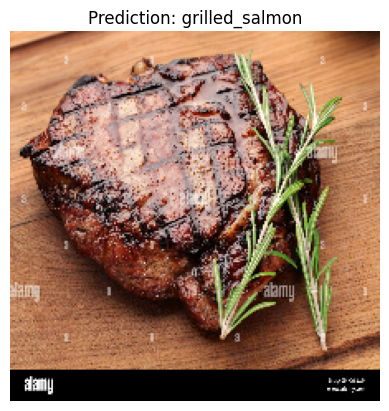

In [ ]:
pred_and_plot(resnet_model, 'beef-steak-on-a-wooden-table-CY92WM.jpg')

In [ ]:
!wget 'https://www.kwestiasmaku.com/sites/v123.kwestiasmaku.com/files/smazony_ryz_01.jpg'

--2023-05-13 11:25:36--  https://www.kwestiasmaku.com/sites/v123.kwestiasmaku.com/files/smazony_ryz_01.jpg
Resolving www.kwestiasmaku.com (www.kwestiasmaku.com)... 94.237.108.28
Connecting to www.kwestiasmaku.com (www.kwestiasmaku.com)|94.237.108.28|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 141274 (138K) [image/jpeg]
Saving to: ‘smazony_ryz_01.jpg’

smazony_ryz_01.jpg  100%[===================>] 137.96K   276KB/s    in 0.5s    

2023-05-13 11:25:38 (276 KB/s) - ‘smazony_ryz_01.jpg’ saved [141274/141274]



1/1 [==============================] - 0s 23ms/step


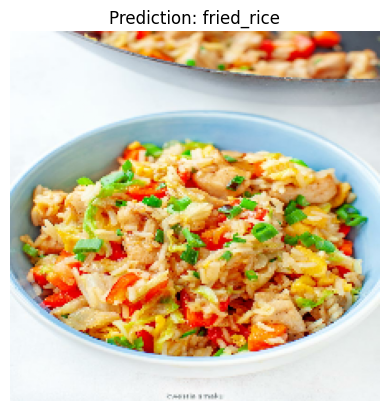

In [ ]:
pred_and_plot(resnet_model, 'smazony_ryz_01.jpg')

In [ ]:
!wget 'https://www.funfoodfrolic.com/wp-content/uploads/2020/09/Chciken-Curry-1.jpg'

--2023-05-13 11:25:38--  https://www.funfoodfrolic.com/wp-content/uploads/2020/09/Chciken-Curry-1.jpg
Resolving www.funfoodfrolic.com (www.funfoodfrolic.com)... 172.67.173.1, 104.21.96.44, 2606:4700:3037::ac43:ad01, ...
Connecting to www.funfoodfrolic.com (www.funfoodfrolic.com)|172.67.173.1|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 174072 (170K) [image/jpeg]
Saving to: ‘Chciken-Curry-1.jpg’

Chciken-Curry-1.jpg 100%[===================>] 169.99K   696KB/s    in 0.2s    

2023-05-13 11:25:40 (696 KB/s) - ‘Chciken-Curry-1.jpg’ saved [174072/174072]



1/1 [==============================] - 0s 24ms/step


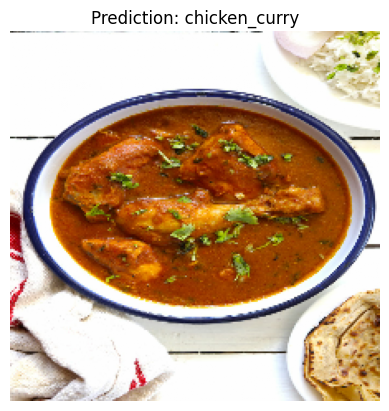

In [ ]:
pred_and_plot(resnet_model, 'Chciken-Curry-1.jpg')

In [ ]:
!wget 'https://www.allrecipes.com/thmb/7QBZje2fP-Q8YFxuvMFIIFp8Byw=/750x0/filters:no_upscale():max_bytes(150000):strip_icc()/140877-easy-eggless-strawberry-ice-cream-ddmfs-3x4-1-092e4d11b59049c8b3843014ea3c57f2.jpg'

--2023-05-13 11:25:40--  https://www.allrecipes.com/thmb/7QBZje2fP-Q8YFxuvMFIIFp8Byw=/750x0/filters:no_upscale():max_bytes(150000):strip_icc()/140877-easy-eggless-strawberry-ice-cream-ddmfs-3x4-1-092e4d11b59049c8b3843014ea3c57f2.jpg
Resolving www.allrecipes.com (www.allrecipes.com)... 151.101.2.137, 151.101.66.137, 151.101.130.137, ...
Connecting to www.allrecipes.com (www.allrecipes.com)|151.101.2.137|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 43524 (43K) [image/jpeg]
Saving to: ‘140877-easy-eggless-strawberry-ice-cream-ddmfs-3x4-1-092e4d11b59049c8b3843014ea3c57f2.jpg’

140877-easy-eggless 100%[===================>]  42.50K  --.-KB/s    in 0.01s   

2023-05-13 11:25:40 (3.41 MB/s) - ‘140877-easy-eggless-strawberry-ice-cream-ddmfs-3x4-1-092e4d11b59049c8b3843014ea3c57f2.jpg’ saved [43524/43524]



1/1 [==============================] - 0s 23ms/step


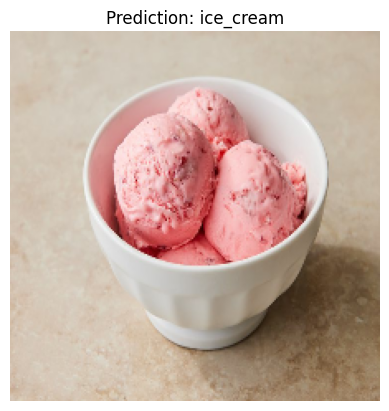

In [ ]:
pred_and_plot(resnet_model, '140877-easy-eggless-strawberry-ice-cream-ddmfs-3x4-1-092e4d11b59049c8b3843014ea3c57f2.jpg')

In [ ]:
!wget 'https://kuron.com.pl/wp-content/uploads/2019/03/P3251115.jpg'

--2023-05-13 11:25:41--  https://kuron.com.pl/wp-content/uploads/2019/03/P3251115.jpg
Resolving kuron.com.pl (kuron.com.pl)... 77.79.202.68
Connecting to kuron.com.pl (kuron.com.pl)|77.79.202.68|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 113761 (111K) [image/jpeg]
Saving to: ‘P3251115.jpg’

P3251115.jpg        100%[===================>] 111.09K   140KB/s    in 0.8s    

2023-05-13 11:25:43 (140 KB/s) - ‘P3251115.jpg’ saved [113761/113761]



1/1 [==============================] - 0s 27ms/step


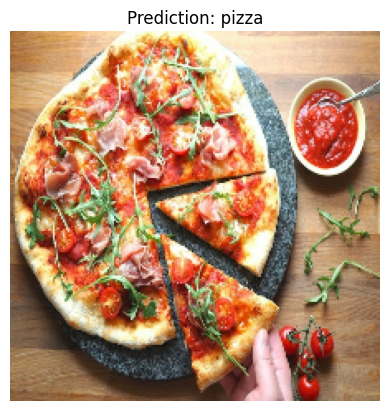

In [ ]:
pred_and_plot(resnet_model, 'P3251115.jpg')

In [ ]:
!wget 'https://houseofasia.pl/wp-content/uploads/2020/12/ramen_z_kurczakiem_house_of_asia_przepis.jpg'

--2023-05-13 11:25:44--  https://houseofasia.pl/wp-content/uploads/2020/12/ramen_z_kurczakiem_house_of_asia_przepis.jpg
Resolving houseofasia.pl (houseofasia.pl)... 3.78.26.6
Connecting to houseofasia.pl (houseofasia.pl)|3.78.26.6|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 124299 (121K) [image/jpeg]
Saving to: ‘ramen_z_kurczakiem_house_of_asia_przepis.jpg’

ramen_z_kurczakiem_ 100%[===================>] 121.39K   158KB/s    in 0.8s    

2023-05-13 11:25:46 (158 KB/s) - ‘ramen_z_kurczakiem_house_of_asia_przepis.jpg’ saved [124299/124299]



1/1 [==============================] - 0s 23ms/step


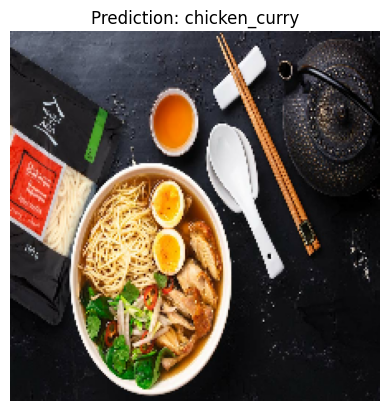

In [ ]:
pred_and_plot(resnet_model, 'ramen_z_kurczakiem_house_of_asia_przepis.jpg')

In [ ]:
!wget 'https://www.kikkoman.pl/fileadmin/_processed_/b/0/csm_kikkoman-rezepte-content-gunkan-maki-sushi-1080x720_168da90abf.jpg'

--2023-05-13 11:26:37--  https://www.kikkoman.pl/fileadmin/_processed_/b/0/csm_kikkoman-rezepte-content-gunkan-maki-sushi-1080x720_168da90abf.jpg
Resolving www.kikkoman.pl (www.kikkoman.pl)... 193.53.251.161
Connecting to www.kikkoman.pl (www.kikkoman.pl)|193.53.251.161|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 103932 (101K) [image/jpeg]
Saving to: ‘csm_kikkoman-rezepte-content-gunkan-maki-sushi-1080x720_168da90abf.jpg.1’

csm_kikkoman-rezept 100%[===================>] 101.50K   392KB/s    in 0.3s    

2023-05-13 11:26:39 (392 KB/s) - ‘csm_kikkoman-rezepte-content-gunkan-maki-sushi-1080x720_168da90abf.jpg.1’ saved [103932/103932]



1/1 [==============================] - 0s 24ms/step


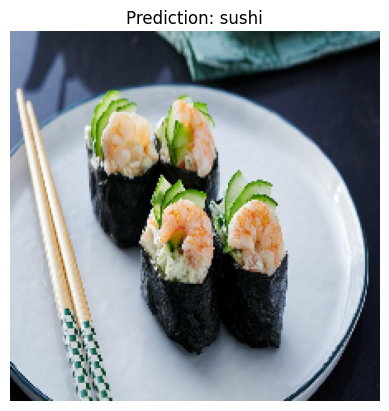

In [ ]:
pred_and_plot(resnet_model, 'csm_kikkoman-rezepte-content-gunkan-maki-sushi-1080x720_168da90abf.jpg')

In [ ]:
!wget 'https://cdn.galleries.smcloud.net/t/galleries/gf-8T5Y-fzK5-4ptH_domowy-hamburger-z-kurczakiem-pyszny-i-zdrowy-664x442-nocrop.jpg'

--2023-05-13 11:26:39--  https://cdn.galleries.smcloud.net/t/galleries/gf-8T5Y-fzK5-4ptH_domowy-hamburger-z-kurczakiem-pyszny-i-zdrowy-664x442-nocrop.jpg
Resolving cdn.galleries.smcloud.net (cdn.galleries.smcloud.net)... 212.180.238.55, 212.180.238.58
Connecting to cdn.galleries.smcloud.net (cdn.galleries.smcloud.net)|212.180.238.55|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 62712 (61K) [image/jpeg]
Saving to: ‘gf-8T5Y-fzK5-4ptH_domowy-hamburger-z-kurczakiem-pyszny-i-zdrowy-664x442-nocrop.jpg’

gf-8T5Y-fzK5-4ptH_d 100%[===================>]  61.24K   241KB/s    in 0.3s    

2023-05-13 11:26:41 (241 KB/s) - ‘gf-8T5Y-fzK5-4ptH_domowy-hamburger-z-kurczakiem-pyszny-i-zdrowy-664x442-nocrop.jpg’ saved [62712/62712]



1/1 [==============================] - 0s 25ms/step


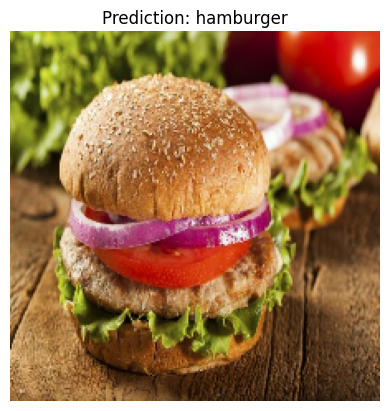

In [ ]:
pred_and_plot(resnet_model, 'gf-8T5Y-fzK5-4ptH_domowy-hamburger-z-kurczakiem-pyszny-i-zdrowy-664x442-nocrop.jpg')

In [ ]:
!wget 'https://assets.epicurious.com/photos/594bff7e1c09de5a334664fe/1:1/w_2240,c_limit/three-ingredient-gochochang-Chicken-Wings-20062017.jpg'

--2023-05-13 11:26:41--  https://assets.epicurious.com/photos/594bff7e1c09de5a334664fe/1:1/w_2240,c_limit/three-ingredient-gochochang-Chicken-Wings-20062017.jpg
Resolving assets.epicurious.com (assets.epicurious.com)... 151.101.0.239, 151.101.64.239, 151.101.128.239, ...
Connecting to assets.epicurious.com (assets.epicurious.com)|151.101.0.239|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 299009 (292K) [image/jpeg]
Saving to: ‘three-ingredient-gochochang-Chicken-Wings-20062017.jpg’

three-ingredient-go 100%[===================>] 292.00K  --.-KB/s    in 0.04s   

2023-05-13 11:26:42 (7.45 MB/s) - ‘three-ingredient-gochochang-Chicken-Wings-20062017.jpg’ saved [299009/299009]



1/1 [==============================] - 0s 29ms/step


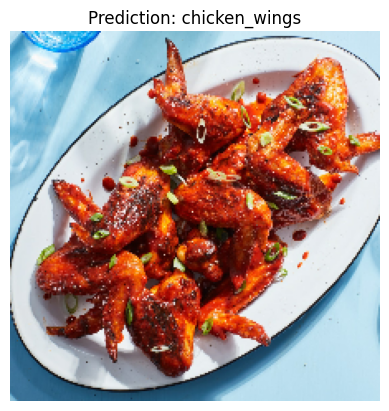

In [ ]:
pred_and_plot(resnet_model, 'three-ingredient-gochochang-Chicken-Wings-20062017.jpg')

In [ ]:
!wget 'https://hips.hearstapps.com/hmg-prod/images/how-to-grill-salmon-recipe2-1655870552.jpg'

--2023-05-13 11:41:35--  https://hips.hearstapps.com/hmg-prod/images/how-to-grill-salmon-recipe2-1655870552.jpg
Resolving hips.hearstapps.com (hips.hearstapps.com)... 151.101.0.155, 151.101.64.155, 151.101.128.155, ...
Connecting to hips.hearstapps.com (hips.hearstapps.com)|151.101.0.155|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 506647 (495K) [image/jpeg]
Saving to: ‘how-to-grill-salmon-recipe2-1655870552.jpg’

how-to-grill-salmon 100%[===================>] 494.77K  --.-KB/s    in 0.05s   

2023-05-13 11:41:35 (10.6 MB/s) - ‘how-to-grill-salmon-recipe2-1655870552.jpg’ saved [506647/506647]



1/1 [==============================] - 0s 23ms/step


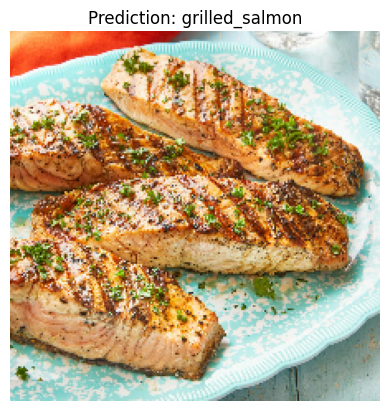

In [ ]:
pred_and_plot(resnet_model, 'how-to-grill-salmon-recipe2-1655870552.jpg')

### Create and Test EfficientNet TensorFlow Hub feature extraction model

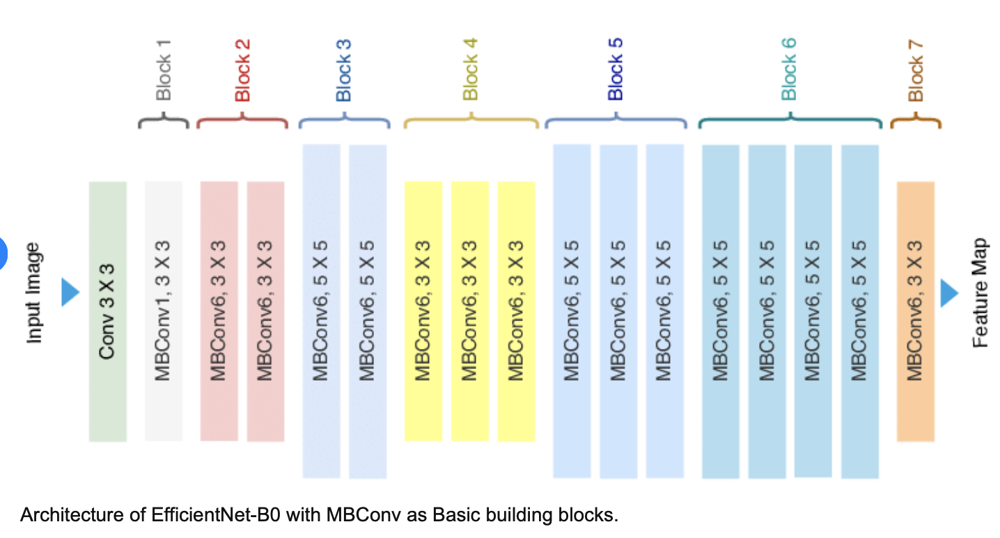

#### Model

In [ ]:
efficientnet_model = create_model(efficientnet_url, 
                                  num_classes = train_data.num_classes)

In [ ]:
efficientnet_model.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 feature_extraction_layer (K  (None, 1280)             4049564   
 erasLayer)                                                      
                                                                 
 output_layer (Dense)        (None, 10)                12810     
                                                                 
Total params: 4,062,374
Trainable params: 12,810
Non-trainable params: 4,049,564
_________________________________________________________________


#### Compile

In [ ]:
efficientnet_model.compile(
    optimizer = tf.keras.optimizers.Adam(),
    loss = 'categorical_crossentropy',
    metrics = ['accuracy']
)

#### Fit

In [ ]:
efficientnet_history = efficientnet_model.fit(
    train_data,
    epochs = 5,
    steps_per_epoch = len(train_data),
    validation_data = test_data,
    validation_steps = len(test_data),
    callbacks = create_tensorboard_callback('transfer_learning', 'EfficientNet_model_v.1.1')
)

Saving TensorBoard log files to: transfer_learning/EfficientNet_model_v.1.1104211 - 05/13/23422023
Epoch 1/5
24/24 [==============================] - 28s 751ms/step - loss: 1.8177 - accuracy: 0.4693 - val_loss: 1.2641 - val_accuracy: 0.7424
Epoch 2/5
24/24 [==============================] - 16s 672ms/step - loss: 1.0462 - accuracy: 0.7827 - val_loss: 0.8509 - val_accuracy: 0.8164
Epoch 3/5
24/24 [==============================] - 16s 666ms/step - loss: 0.7444 - accuracy: 0.8480 - val_loss: 0.6897 - val_accuracy: 0.8392
Epoch 4/5
24/24 [==============================] - 16s 666ms/step - loss: 0.5982 - accuracy: 0.8760 - val_loss: 0.6051 - val_accuracy: 0.8496
Epoch 5/5
24/24 [==============================] - 16s 671ms/step - loss: 0.5083 - accuracy: 0.8893 - val_loss: 0.5530 - val_accuracy: 0.8588


#### Evaluate

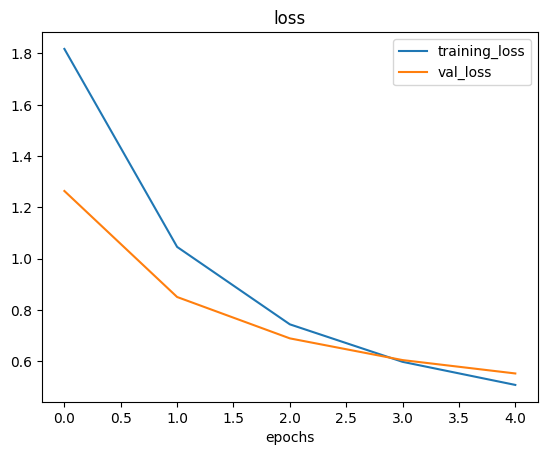

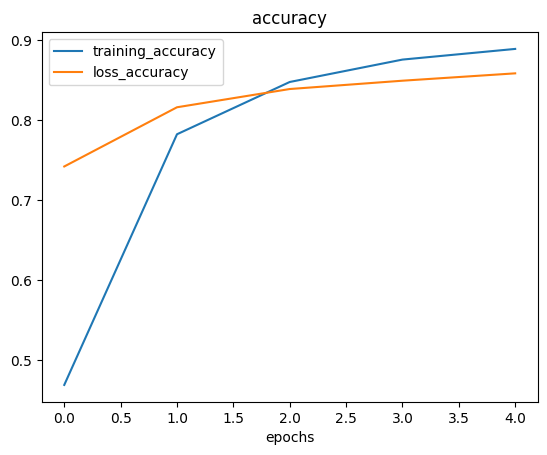

In [ ]:
plot_loss_accuracy_curves(efficientnet_history)

Same, here model overfitts a bit. But let's use that, anyway!

In [ ]:
efficientnet_model.evaluate(test_data)

79/79 [==============================] - 12s 152ms/step - loss: 0.5530 - accuracy: 0.8588


[0.5529533624649048, 0.8587999939918518]

EfficientNet model performed better than ResNet!

#### Predict

1/1 [==============================] - 1s 1s/step


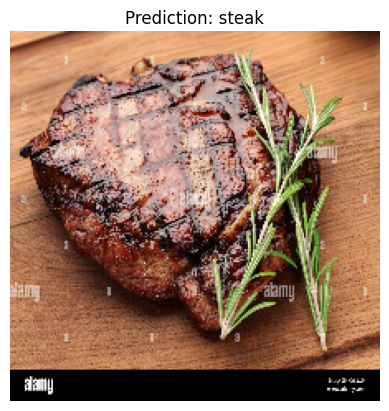

In [ ]:
pred_and_plot(efficientnet_model, 'beef-steak-on-a-wooden-table-CY92WM.jpg')

1/1 [==============================] - 0s 28ms/step


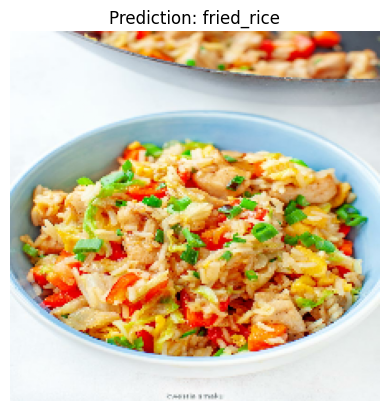

In [ ]:
pred_and_plot(efficientnet_model, 'smazony_ryz_01.jpg')

1/1 [==============================] - 0s 27ms/step


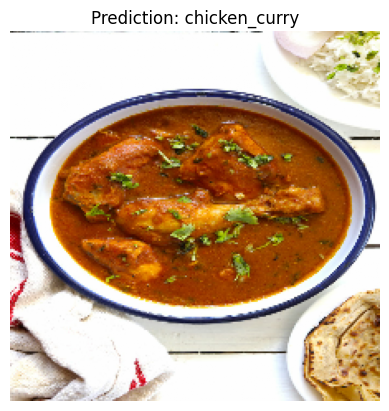

In [ ]:
pred_and_plot(efficientnet_model, 'Chciken-Curry-1.jpg')

WOW! It got chicken curry, ResNet detect chicken curry as ramen!

1/1 [==============================] - 0s 26ms/step


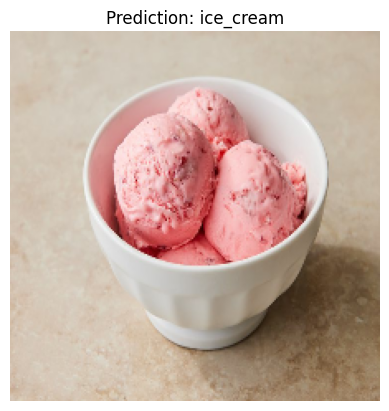

In [ ]:
pred_and_plot(efficientnet_model, '140877-easy-eggless-strawberry-ice-cream-ddmfs-3x4-1-092e4d11b59049c8b3843014ea3c57f2.jpg')

1/1 [==============================] - 0s 26ms/step


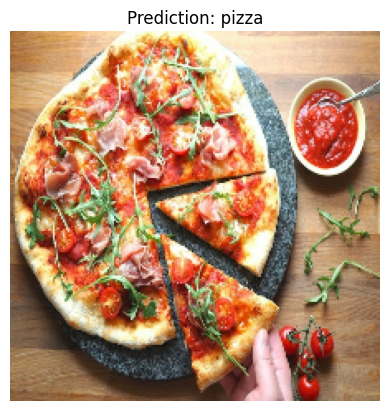

In [ ]:
pred_and_plot(efficientnet_model, 'P3251115.jpg')

1/1 [==============================] - 0s 29ms/step


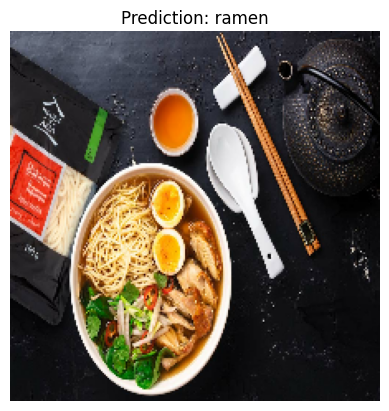

In [ ]:
pred_and_plot(efficientnet_model, 'ramen_z_kurczakiem_house_of_asia_przepis.jpg')

1/1 [==============================] - 0s 27ms/step


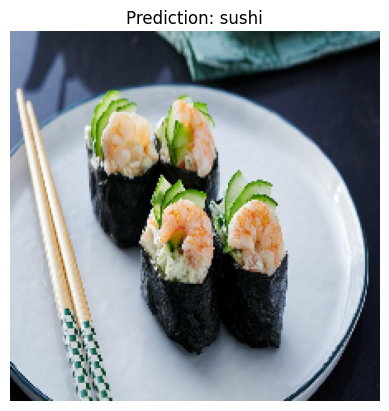

In [ ]:
pred_and_plot(efficientnet_model, 'csm_kikkoman-rezepte-content-gunkan-maki-sushi-1080x720_168da90abf.jpg')

1/1 [==============================] - 0s 26ms/step


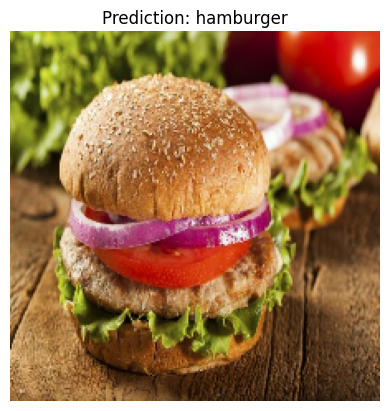

In [ ]:
pred_and_plot(efficientnet_model, 'gf-8T5Y-fzK5-4ptH_domowy-hamburger-z-kurczakiem-pyszny-i-zdrowy-664x442-nocrop.jpg')

1/1 [==============================] - 0s 29ms/step


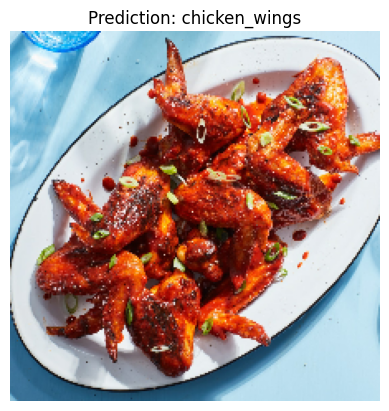

In [ ]:
pred_and_plot(efficientnet_model, 'three-ingredient-gochochang-Chicken-Wings-20062017.jpg')

1/1 [==============================] - 0s 62ms/step


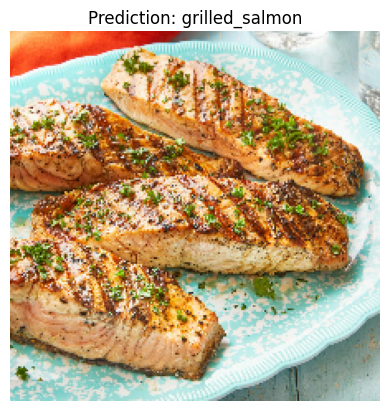

In [ ]:
pred_and_plot(efficientnet_model, 'how-to-grill-salmon-recipe2-1655870552.jpg')

Awesome! Most of the photos were detected properly. Main difficulty was based on similarities between dishes e.g. chicken curry and ramen, obviously it doesn'e taste similar however both dishes are often placed in bowls what could confuse the model. Similar thing was going on with grilled salmmon and steak, the structure and burnt stripes can confuse the model. Eventually EfficientNet model performed better than ResNet50 becuause of better evaluation, so on the bigger dataset EfficientNet would perform better.



---

There are 3 types of transfer learning:

* **'As Is' Transfer Learning** - we take model as is from e.g. TensorFlow Hub and use it right away, without changing any of the layers including output layer.
* **Feature Extraction Transfer Learning** - this one we've just done. So we take already created and trained model, architecture and change only output layer to adjust the model for our specific needs. In our example we changed output layer from 1000 classes down to 10 classes, which makes this approach a Feature Extraction Transfer Learning.
* **Fine-tunning Transfer Learning** - here we change some of the layers or even all of them, we change architevture, change aprameters, etc. We won't be able to find model for our specific needs everytime, however the problem which is solved by available model can be close enough to our issue to use it after some changes. This is situation when we should use Fine-tunning.

Let's see al weights of trained efficientnet_model

In [ ]:
len(efficientnet_model.layers[0].weights)

309

### Integration with TensorBoard

All projects that are published on TensorBoard are public, so if you have any projects that got to stay private do not use TensorBoard.

Also keep that in mind to use TensorBoard you needed to initialize TensorBoard callback in callbacks in fit method. Then you'll need to pass directory where you're callback were stored.

In [ ]:
!tensorboard dev upload --logdir ./transfer_learning/ \
  --name 'EfficientNetB0 vs ResNet50' \
  --description 'Comparing two different TF Hub feature extraction model architectures using 10% of training data' \
  --one_shot

After going to the link: https://tensorboard.dev/experiment/VoN7lF9CQ6efPwDgT0nQqQ/ we're going to see below view

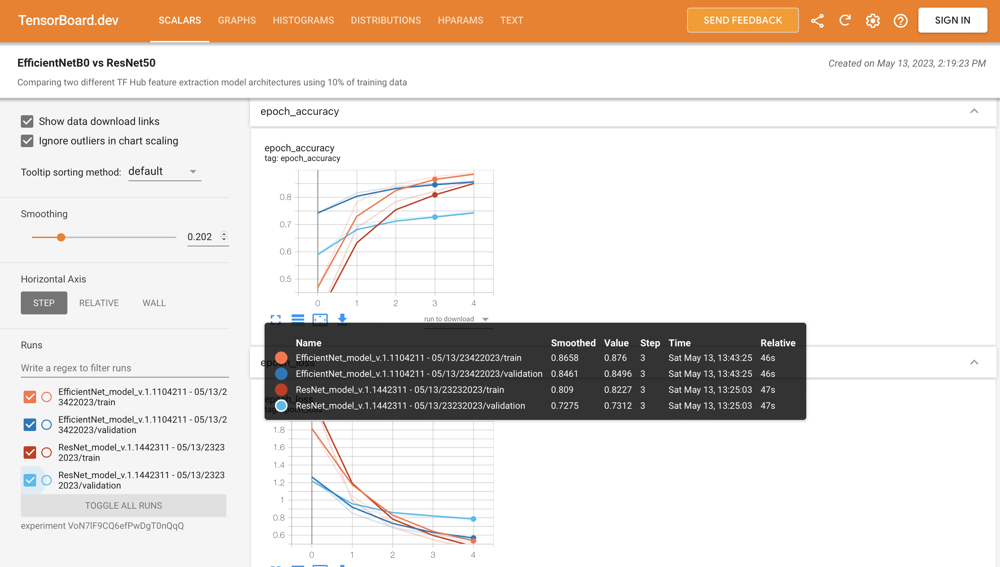

Checkout witch experiments you have of TensorBoard

In [ ]:
!tensorboard dev list

2023-05-13 12:26:29.599500: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT
https://tensorboard.dev/experiment/VoN7lF9CQ6efPwDgT0nQqQ/
	Name                 EfficientNetB0 vs ResNet50
	Description          Comparing two different TF Hub feature extraction model architectures using 10% of training data
	Id                   VoN7lF9CQ6efPwDgT0nQqQ
	Created              2023-05-13 12:19:23 (7 minutes ago)
	Updated              2023-05-13 12:19:27 (7 minutes ago)
	Runs                 4
	Tags                 5
	Scalars              60
	Tensor bytes         0
	Binary object bytes  5828892
Total: 1 experiment(s)


To delete an experiment from TensorBoard run below line with tensorboard experiment id

In [ ]:
# !tensorboard dev delete --experiment_id VoN7lF9CQ6efPwDgT0nQqQ

In [ ]:
# !tensorboard dev list

## Exercises

### Mobilenet_v2_100 model

#### Model

In [ ]:
mobilenet_url = 'https://tfhub.dev/google/imagenet/mobilenet_v2_100_224/feature_vector/5'

mobilenet_model = create_model(model_url = mobilenet_url,
                               num_classes = train_data.num_classes)

In [ ]:
mobilenet_model.summary()

Model: "sequential_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 feature_extraction_layer (K  (None, 1280)             2257984   
 erasLayer)                                                      
                                                                 
 output_layer (Dense)        (None, 10)                12810     
                                                                 
Total params: 2,270,794
Trainable params: 12,810
Non-trainable params: 2,257,984
_________________________________________________________________


#### Compile

In [ ]:
mobilenet_model.compile(
    optimizer = tf.keras.optimizers.Adam(),
    loss = 'categorical_crossentropy',
    metrics = ['accuracy']
)

#### Fit

In [ ]:
mobilenet_history = mobilenet_model.fit(
    train_data,
    epochs = 5,
    steps_per_epoch = len(train_data),
    validation_data = test_data,
    validation_steps = len(test_data),
    callbacks = create_tensorboard_callback('transfer_learning', 'MobileNet_V2_100_v.1')
)

Saving TensorBoard log files to: transfer_learning/MobileNet_V2_100_v.1433213 - 05/13/23322023
Epoch 1/5
24/24 [==============================] - 16s 674ms/step - loss: 0.7234 - accuracy: 0.7987 - val_loss: 0.7499 - val_accuracy: 0.7700
Epoch 2/5
24/24 [==============================] - 18s 786ms/step - loss: 0.5796 - accuracy: 0.8387 - val_loss: 0.6853 - val_accuracy: 0.7868
Epoch 3/5
24/24 [==============================] - 17s 738ms/step - loss: 0.4780 - accuracy: 0.8827 - val_loss: 0.6430 - val_accuracy: 0.8048
Epoch 4/5
24/24 [==============================] - 17s 741ms/step - loss: 0.4013 - accuracy: 0.9040 - val_loss: 0.6184 - val_accuracy: 0.8024
Epoch 5/5
24/24 [==============================] - 16s 672ms/step - loss: 0.3527 - accuracy: 0.9253 - val_loss: 0.6049 - val_accuracy: 0.8048


#### Evaluate

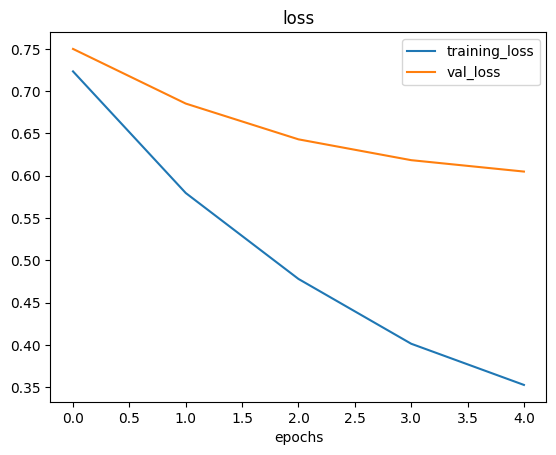

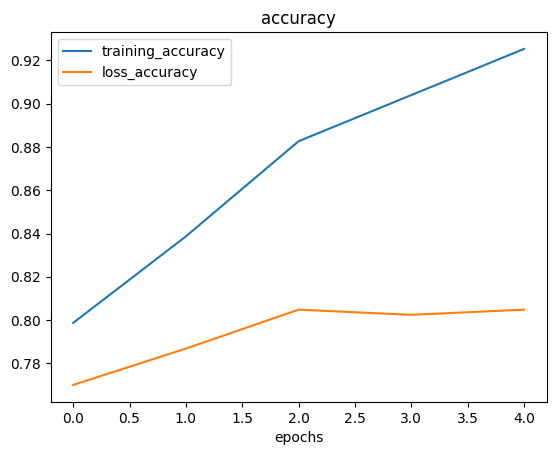

In [ ]:
plot_loss_accuracy_curves(mobilenet_history)

In [ ]:
mobilenet_model.evaluate(test_data)

79/79 [==============================] - 12s 153ms/step - loss: 0.6049 - accuracy: 0.8048


[0.6049192547798157, 0.8047999739646912]

#### Compare with other models on TensorBoard

In [ ]:
!tensorboard dev upload --logdir ./transfer_learning/ \
  --name 'EfficientNetB0 vs ResNet50 vs MobileNet100' \
  --description 'Comparing three different TF Hub feature extraction model architectures using 10% of training data' \
  --one_shot

Done. View your TensorBoard at https://tensorboard.dev/experiment/KjLp3emeQRK3gddYYXe99A/

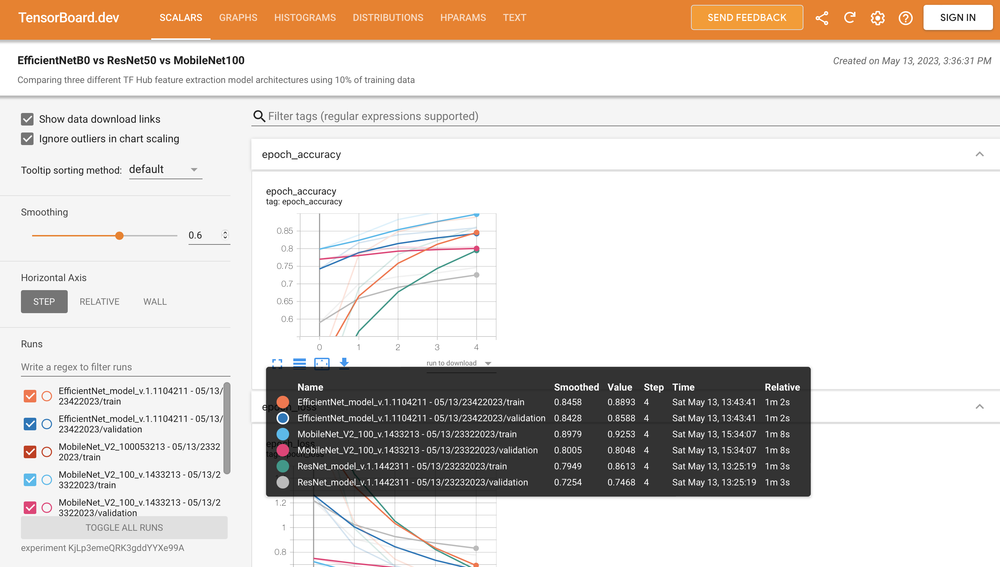

Train accuracy seems to be the best for MobileNet100, however validation accuracy is not that great which means the model overfits. It's obviously good model, and it performed better than ResNet50, but the best model still is EfficientNet

### 3 Models we haven't go through available on TensorHub

* nasnet_large
* resnet_v2_101
* inception_v3

### Pedestrian vs. Cyclyst detection model

#### Get 10 train photos for each class

In [ ]:
mkdir 'train'

In [ ]:
cd 'train'

/content/train


In [ ]:
mkdir 'cyclists'

In [ ]:
cd 'cyclists'

/content/train/cyclists


In [ ]:
!wget 'https://www.sunset.com/wp-content/uploads/1422e4f0e374bcaad442c74d75077469-750x0-c-default.jpg' 'https://hips.hearstapps.com/hmg-prod/images/people-cycling-on-street-in-city-royalty-free-image-881171152-1534441287.jpg' 'https://i.cbc.ca/1.5943910.1615917564!/cumulusImage/httpImage/image.jpg_gen/derivatives/16x9_780/covid-19-bloor-st-cyclists-march-9.jpg' 'https://images.prismic.io/luko/49d0a0d8-aea8-4873-a47b-920bd187c31d_Picture_hero-bike-index.jpg' 'https://austin.culturemap.com/media-library/cyclist-bicycle-woman-on-boke.jpg?id=31479745&width=2000&height=1500&quality=85&coordinates=0%2C0%2C0%2C0' 'https://a.storyblok.com/f/69709/1500x844/5b3515aff7/raleigh-strada-bike-cycling-city-legs-up.jpg' 'https://www.gannett-cdn.com/-mm-/0c86f78787246edd38c03ca7db6c35e4d8a335b0/c=425-0-4435-3015/local/-/media/2016/01/12/IAGroup/DesMoines/635882200521427559-mpls-edit-MacG-5973-copy.jpg' 'https://cdn.vox-cdn.com/thumbor/ihCyJG1s8ckRhxXpv1bfSSc-9Tg=/0x0:5579x3710/1820x1213/filters:focal(2930x1017:3822x1909):format(webp)/cdn.vox-cdn.com/uploads/chorus_image/image/61053221/IMG_3142.0.jpg' 'https://www.cycleabouttown.com/wp-content/uploads/2021/01/Untitled-design-69.jpg' 'https://www.vivination.co.uk/wp-content/uploads/2021/07/roman-koester-v53RV9LL5y0-unsplash.jpg'  'https://www.holland.com/upload_mm/5/a/0/78316_fullimage_fietsen%20langs%20de%20ijssel%20met%20als%20decor%20de%20skyline%20van%20hanzestad%20kampen%20%C2%A9%20gijs%20versteeg%20via%20marketingoost_1360x430_0.jpg' 'https://www.greenpeace.org.uk/wp-content/uploads/2020/06/200620-3286-Edit-1216x810.jpg'

--2023-05-22 09:49:48--  https://www.sunset.com/wp-content/uploads/1422e4f0e374bcaad442c74d75077469-750x0-c-default.jpg
Resolving www.sunset.com (www.sunset.com)... 141.193.213.10, 141.193.213.11
Connecting to www.sunset.com (www.sunset.com)|141.193.213.10|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 68778 (67K) [image/jpeg]
Saving to: ‘1422e4f0e374bcaad442c74d75077469-750x0-c-default.jpg’

1422e4f0e374bcaad44 100%[===================>]  67.17K  --.-KB/s    in 0.01s   

2023-05-22 09:49:48 (5.54 MB/s) - ‘1422e4f0e374bcaad442c74d75077469-750x0-c-default.jpg’ saved [68778/68778]

--2023-05-22 09:49:48--  https://hips.hearstapps.com/hmg-prod/images/people-cycling-on-street-in-city-royalty-free-image-881171152-1534441287.jpg
Resolving hips.hearstapps.com (hips.hearstapps.com)... 151.101.0.155, 151.101.64.155, 151.101.128.155, ...
Connecting to hips.hearstapps.com (hips.hearstapps.com)|151.101.0.155|:443... connected.
HTTP request sent, awaiting response... 200 

In [ ]:
cd ..

/content/train


In [ ]:
mkdir 'pedestrians'

In [ ]:
cd 'pedestrians'

/content/train/pedestrians


In [ ]:
!wget 'https://cdn-hhemp.nitrocdn.com/CzTrBAAAQEDiquGqUnZSWpxDsbIQwMVJ/assets/images/optimized/rev-d07532f/wp-content/uploads/2021/06/woman-crossing.jpg' 'https://callsam.com/wp-content/uploads/2019/12/crosswalk-featured.jpg' 'https://www.hennessandhaight.com/wp-content/uploads/2019/02/pedestrian-safety-tips.jpg' 'https://highways.dot.gov/sites/fhwa.dot.gov/files/images/psc_walkways-1.jpg' 'http://www.thinkstreetsmart.org/uploads/1/2/7/4/127450599/editor/sfdanburdenattrib.jpg?1597340859' 'https://www.nyc.gov/html/dot/images/pedestrians/ped-ramps-bay-ridge-ave.jpg' 'https://today.duke.edu/sites/default/files/legacy-files/legacy_files/news_images/sidewalk468.jpg' 'https://www.cityofsacramento.org/-/media/Corporate/Images/Public-Works/Transportation/PedestrianProg.jpg?la=en' 'https://bloximages.chicago2.vip.townnews.com/sfexaminer.com/content/tncms/assets/v3/editorial/b/f9/bf9249b0-a650-5128-b58f-974fff8cd88c/628e5f2d49cf6.image.jpg' 'https://encrypted-tbn0.gstatic.com/images?q=tbn:ANd9GcS9ZO6Z2Px7UKc6oJS9nqcOtdZQtC59QTPhhg&usqp=CAU' ''

--2023-05-22 09:49:52--  https://cdn-hhemp.nitrocdn.com/CzTrBAAAQEDiquGqUnZSWpxDsbIQwMVJ/assets/images/optimized/rev-d07532f/wp-content/uploads/2021/06/woman-crossing.jpg
Resolving cdn-hhemp.nitrocdn.com (cdn-hhemp.nitrocdn.com)... 104.18.40.108, 172.64.147.148, 2606:4700:4400::ac40:9394, ...
Connecting to cdn-hhemp.nitrocdn.com (cdn-hhemp.nitrocdn.com)|104.18.40.108|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 183265 (179K) [image/jpeg]
Saving to: ‘woman-crossing.jpg’

woman-crossing.jpg  100%[===================>] 178.97K  --.-KB/s    in 0.03s   

2023-05-22 09:49:52 (6.56 MB/s) - ‘woman-crossing.jpg’ saved [183265/183265]

--2023-05-22 09:49:52--  https://callsam.com/wp-content/uploads/2019/12/crosswalk-featured.jpg
Resolving callsam.com (callsam.com)... 209.126.16.136
Connecting to callsam.com (callsam.com)|209.126.16.136|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 264920 (259K) [image/jpeg]
Saving to: ‘crosswalk-featured.j

#### Data Loaders

In [ ]:
from tensorflow.keras.preprocessing.image import ImageDataGenerator

IMG_SIZE = (224, 224)
BATCH_SIZE = 10

train_dir = '/content/train/'

train_datagen = ImageDataGenerator(rescale = 1/255.)

train_data = train_datagen.flow_from_directory(train_dir,
                                               batch_size = BATCH_SIZE,
                                               target_size = IMG_SIZE,
                                               class_mode = 'binary')

Found 16 images belonging to 2 classes.


#### Model URL

In [ ]:
efficientnet_url = 'https://tfhub.dev/tensorflow/efficientnet/b0/feature-vector/1'

#### Import dependencies

In [ ]:
import tensorflow as tf
import tensorflow_hub as hub
from tensorflow.keras import layers

#### Class names

In [ ]:
import numpy as np

In [ ]:
cd /content/train

/content/train


In [ ]:
import glob

class_names = np.array(sorted([i for i in glob.glob('*')]))
class_names

array(['cyclists', 'pedestrians'], dtype='<U11')

#### Create Model

We need to change output layer activation function from softmax as in 10 class classification into sigmoid for binary classification. Also we need to change num_class to 1 in output number of points.

In [ ]:
def create_model(model_url, num_classes = 10):
  """
  Takes a TensorFlow hub url and creates Keras Sequential model

  Args:
    model_url (str): TensorFlow Hub feature extraction model URL
    num_classes (int): Number of output neurons in the output layer. Should be equal of number target classes, default 10.

  Returns:
    An uncompiled Keras Sequential model with model_url as feature extractor layer and Dense output layer with num_classes output neurons.
  """
  TARGET_IMG_SHAPE = (224, 224)
  # Download pretrained model and save it as Keras layer
  feature_extractor_layer = hub.KerasLayer(model_url,
                                           trainable = False, # Freeze the already learned patterns
                                           name = 'feature_extraction_layer',
                                           input_shape = TARGET_IMG_SHAPE + (3,)) 


  # Create our own model
  model = tf.keras.Sequential([
      feature_extractor_layer,
      layers.Dense(1, activation = 'sigmoid', name = 'output_layer')
  ])

  return model

#### Model

In [ ]:
efficiency_model_exercise = create_model(efficientnet_url,
                                         num_classes = train_data.num_classes)

In [ ]:
efficiency_model_exercise.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 feature_extraction_layer (K  (None, 1280)             4049564   
 erasLayer)                                                      
                                                                 
 output_layer (Dense)        (None, 1)                 1281      
                                                                 
Total params: 4,050,845
Trainable params: 1,281
Non-trainable params: 4,049,564
_________________________________________________________________


#### Compile

In [ ]:
efficiency_model_exercise.compile(
                                  loss = 'binary_crossentropy',
                                  optimizer = tf.keras.optimizers.Adam(),
                                  metrics = ['accuracy']
)

#### Fit

In [ ]:
history = efficiency_model_exercise.fit(
                              train_data,
                              epochs = 5,
                              steps_per_epoch = len(train_data)
)

Epoch 1/5
2/2 [==============================] - 19s 558ms/step - loss: 0.7058 - accuracy: 0.4375
Epoch 2/5
2/2 [==============================] - 1s 152ms/step - loss: 0.5934 - accuracy: 0.8125
Epoch 3/5
2/2 [==============================] - 1s 92ms/step - loss: 0.5158 - accuracy: 0.9375
Epoch 4/5
2/2 [==============================] - 1s 67ms/step - loss: 0.4427 - accuracy: 1.0000
Epoch 5/5
2/2 [==============================] - 1s 480ms/step - loss: 0.3793 - accuracy: 1.0000


#### Predict

In [ ]:
!wget 'http://uknow.uky.edu/sites/default/files/styles/uknow_story_image/public/190129SNOW132%20copy.JPG'

--2023-05-22 09:55:31--  http://uknow.uky.edu/sites/default/files/styles/uknow_story_image/public/190129SNOW132%20copy.JPG
Resolving uknow.uky.edu (uknow.uky.edu)... 34.203.131.53, 52.23.105.57
Connecting to uknow.uky.edu (uknow.uky.edu)|34.203.131.53|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 118805 (116K) [image/jpeg]
Saving to: ‘190129SNOW132 copy.JPG.1’

190129SNOW132 copy. 100%[===================>] 116.02K  --.-KB/s    in 0.06s   

2023-05-22 09:55:31 (1.98 MB/s) - ‘190129SNOW132 copy.JPG.1’ saved [118805/118805]



1/1 [==============================] - 2s 2s/step


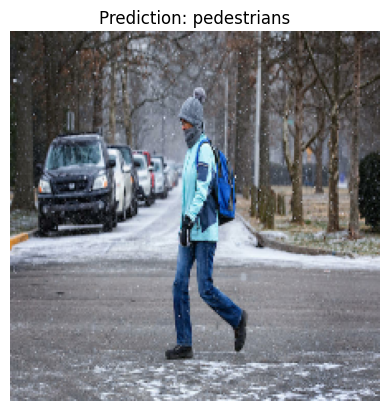

In [ ]:
pred_and_plot(model = efficiency_model_exercise, filename = '190129SNOW132 copy.JPG')

In [ ]:
!wget 'https://assets.bwbx.io/images/users/iqjWHBFdfxIU/i2Dv9M2W0Bfs/v1/1400x-1.jpg'

--2023-05-22 09:55:33--  https://assets.bwbx.io/images/users/iqjWHBFdfxIU/i2Dv9M2W0Bfs/v1/1400x-1.jpg
Resolving assets.bwbx.io (assets.bwbx.io)... 151.101.1.73, 151.101.65.73, 151.101.129.73, ...
Connecting to assets.bwbx.io (assets.bwbx.io)|151.101.1.73|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 178325 (174K) [image/jpeg]
Saving to: ‘1400x-1.jpg’

1400x-1.jpg         100%[===================>] 174.15K  --.-KB/s    in 0.03s   

2023-05-22 09:55:33 (6.13 MB/s) - ‘1400x-1.jpg’ saved [178325/178325]



1/1 [==============================] - 0s 31ms/step


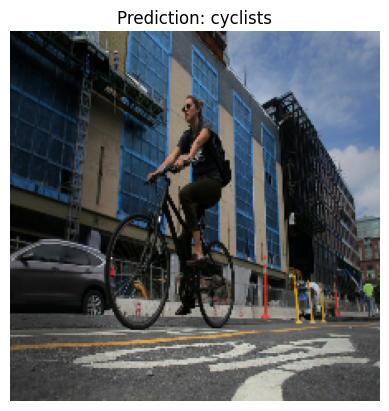

In [ ]:
pred_and_plot(model = efficiency_model_exercise, filename = '1400x-1.jpg')

In [ ]:
!wget 'https://images.7news.com.au/publication/C-736288/fc3832987f18c7e8132938d70bdd71c8f5d17673-16x9-x0y285w5472h3078.jpg'

--2023-05-22 09:55:34--  https://images.7news.com.au/publication/C-736288/fc3832987f18c7e8132938d70bdd71c8f5d17673-16x9-x0y285w5472h3078.jpg
Resolving images.7news.com.au (images.7news.com.au)... 65.8.248.101, 65.8.248.35, 65.8.248.89, ...
Connecting to images.7news.com.au (images.7news.com.au)|65.8.248.101|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 160361 (157K) [image/jpeg]
Saving to: ‘fc3832987f18c7e8132938d70bdd71c8f5d17673-16x9-x0y285w5472h3078.jpg’

fc3832987f18c7e8132 100%[===================>] 156.60K  --.-KB/s    in 0.05s   

2023-05-22 09:55:34 (3.21 MB/s) - ‘fc3832987f18c7e8132938d70bdd71c8f5d17673-16x9-x0y285w5472h3078.jpg’ saved [160361/160361]



1/1 [==============================] - 0s 26ms/step


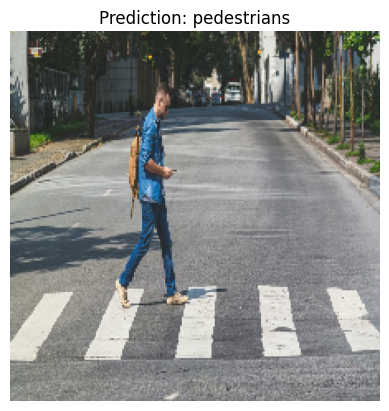

In [ ]:
pred_and_plot(model = efficiency_model_exercise, filename = 'fc3832987f18c7e8132938d70bdd71c8f5d17673-16x9-x0y285w5472h3078.jpg')

In [ ]:
!wget 'https://www.goodnewsnetwork.org/wp-content/uploads/2020/05/cyclist-bicycle-biking-in-street-lane-Europe-pubdomain-Coen-van-den-Broek.jpg'

--2023-05-22 09:55:34--  https://www.goodnewsnetwork.org/wp-content/uploads/2020/05/cyclist-bicycle-biking-in-street-lane-Europe-pubdomain-Coen-van-den-Broek.jpg
Resolving www.goodnewsnetwork.org (www.goodnewsnetwork.org)... 172.67.197.161, 104.21.21.95, 2606:4700:3035::ac43:c5a1, ...
Connecting to www.goodnewsnetwork.org (www.goodnewsnetwork.org)|172.67.197.161|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 97654 (95K) [image/jpeg]
Saving to: ‘cyclist-bicycle-biking-in-street-lane-Europe-pubdomain-Coen-van-den-Broek.jpg’

cyclist-bicycle-bik 100%[===================>]  95.37K  --.-KB/s    in 0.01s   

2023-05-22 09:55:35 (6.44 MB/s) - ‘cyclist-bicycle-biking-in-street-lane-Europe-pubdomain-Coen-van-den-Broek.jpg’ saved [97654/97654]



1/1 [==============================] - 0s 25ms/step


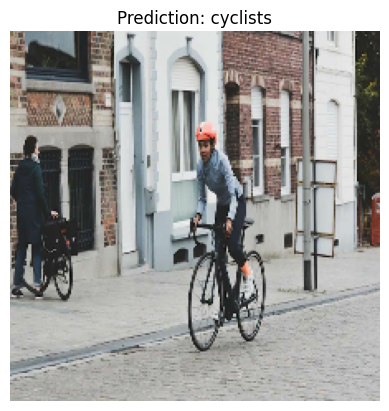

In [ ]:
pred_and_plot(model = efficiency_model_exercise, filename = 'cyclist-bicycle-biking-in-street-lane-Europe-pubdomain-Coen-van-den-Broek.jpg')

In [ ]:
!wget 'https://www.visitcopenhagen.com/sites/visitcopenhagen.com/files/styles/hero/public/2019-04/Bryggebroen_Astrid%20Maria%20Rasmussen.jpg?h=be69db06&itok=XphihleZ'

--2023-05-22 09:55:35--  https://www.visitcopenhagen.com/sites/visitcopenhagen.com/files/styles/hero/public/2019-04/Bryggebroen_Astrid%20Maria%20Rasmussen.jpg?h=be69db06&itok=XphihleZ
Resolving www.visitcopenhagen.com (www.visitcopenhagen.com)... 104.18.5.53, 104.18.4.53, 2606:4700::6812:435, ...
Connecting to www.visitcopenhagen.com (www.visitcopenhagen.com)|104.18.5.53|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: unspecified [image/jpeg]
Saving to: ‘Bryggebroen_Astrid Maria Rasmussen.jpg?h=be69db06&itok=XphihleZ’

Bryggebroen_Astrid      [ <=>                ] 131.72K  --.-KB/s    in 0.1s    

2023-05-22 09:55:36 (1.33 MB/s) - ‘Bryggebroen_Astrid Maria Rasmussen.jpg?h=be69db06&itok=XphihleZ’ saved [134881]



1/1 [==============================] - 0s 25ms/step


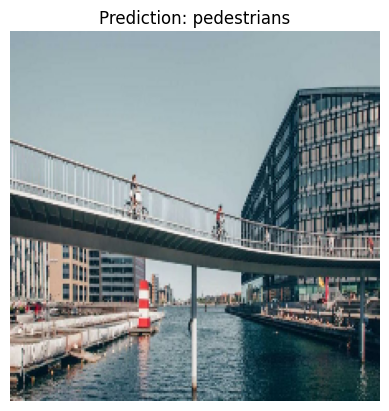

In [ ]:
pred_and_plot(model = efficiency_model_exercise, filename = 'Bryggebroen_Astrid Maria Rasmussen.jpg?h=be69db06&itok=XphihleZ')

Great, vast majority of the predictions were correct. Only last prediction was incorrect, model detected cyclists as pedestrians. However, the photo is not that obvious as the cyclists are behind the fence.

### TF Hub detection of already trained class

Below code is a copy of https://www.tensorflow.org/tutorials/images/transfer_learning_with_hub page

#### Dependencies

In [13]:
import numpy as np
import time

import PIL.Image as Image # Python Imaging Library for image operations
import matplotlib.pylab as plt

import tensorflow as tf
import tensorflow_hub as hub

import datetime

#### Model

We're going to use ImageNet classifier

In [14]:
mobilenet_v2 = 'https://tfhub.dev/google/tf2-preview/mobilenet_v2/classification/4' # model hub link
inception_v3 = 'https://tfhub.dev/google/imagenet/inception_v3/classification/5'

classifier_model = mobilenet_v2

In [15]:
IMAGE_SHAPE = (224, 224)

classifier = tf.keras.Sequential([
    hub.KerasLayer(classifier_model, input_shape = IMAGE_SHAPE + (3,)) # adding 3rd dimension to the image shape due to RGB format
])

#### Predict

Run the model on a single image

61306/61306 [==============================] - 0s 0us/step


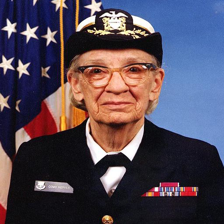

In [16]:
grace_hopper = tf.keras.utils.get_file('image.jpg', 'https://storage.googleapis.com/download.tensorflow.org/example_images/grace_hopper.jpg')
grace_hopper = Image.open(grace_hopper).resize(IMAGE_SHAPE)
grace_hopper

In [17]:
grace_hopper = np.array(grace_hopper)/255.
grace_hopper.shape

(224, 224, 3)

Add new dimension

In [18]:
result = classifier.predict(grace_hopper[np.newaxis])
result.shape

1/1 [==============================] - 8s 8s/step


(1, 1001)

In [19]:
result

array([[ 0.19971317,  1.0666476 , -0.10109331, ...,  0.15688556,
        -0.60558677, -0.04497562]], dtype=float32)

Result is an array of 1001 classes with probability of each class

In [20]:
predicted_class = np.argmax(result)
predicted_class

653

#### Decode Predictions

In [21]:
labels_path = tf.keras.utils.get_file('ImageNetLabels.txt', 'https://storage.googleapis.com/download.tensorflow.org/data/ImageNetLabels.txt') # link to classes
imagenet_labels = np.array(open(labels_path).read().splitlines()) # openning, splitting and saving labels
imagenet_labels

10484/10484 [==============================] - 0s 0us/step


array(['background', 'tench', 'goldfish', ..., 'bolete', 'ear',
       'toilet tissue'], dtype='<U30')

Text(0.5, 1.0, 'Prediction: military uniform')

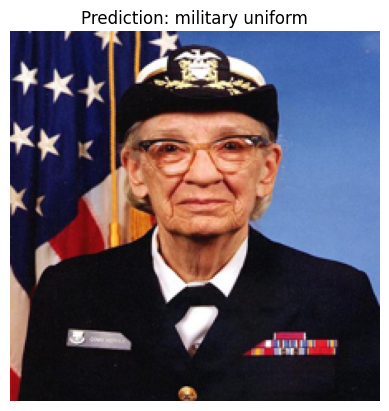

In [22]:
plt.imshow(grace_hopper)
plt.axis(False)
plt.title('Prediction: ' + imagenet_labels[predicted_class])

### TF Hub detection of not yet trained class

#### Dependencies

In [23]:
import numpy as np
import time

import PIL.Image as Image # Python Imaging Library for image operations
import matplotlib.pylab as plt

import tensorflow as tf
import tensorflow_hub as hub

import datetime

#### Data

In [24]:
data_root = tf.keras.utils.get_file(
    'flower_photos',
    'https://storage.googleapis.com/download.tensorflow.org/example_images/flower_photos.tgz',
    untar = True, # extract file automatically if file is in tar format
)

228813984/228813984 [==============================] - 1s 0us/step


In [25]:
batch_size = 32
image_height = 224
image_width = 224

train_ds = tf.keras.utils.image_dataset_from_directory(
    str(data_root),
    validation_split = 0.2,
    subset = 'training',
    seed = 123,
    image_size = (image_height, image_width),
    batch_size = batch_size
)

val_ds = tf.keras.utils.image_dataset_from_directory(
    str(data_root),
    validation_split = 0.2,
    subset = 'validation',
    seed = 123,
    image_size = (image_height, image_width),
    batch_size = batch_size
)

Found 3670 files belonging to 5 classes.
Using 2936 files for training.
Found 3670 files belonging to 5 classes.
Using 734 files for validation.


In [26]:
class_names = np.array(train_ds.class_names)
class_names

array(['daisy', 'dandelion', 'roses', 'sunflowers', 'tulips'],
      dtype='<U10')

#### Normalization

In [27]:
normalization_layer = tf.keras.layers.Rescaling(1./255)
train_ds = train_ds.map(lambda x, y: (normalization_layer(x), y)) # Where x—images, y—labels.
val_ds = val_ds.map(lambda x, y: (normalization_layer(x), y)) # Where x—images, y—labels.

Prevent I/O blockage

#### AUTOTUNE

In [28]:
AUTOTUNE = tf.data.AUTOTUNE
train_ds = train_ds.cache().prefetch(buffer_size = AUTOTUNE)
val_df = val_ds.cache().prefetch(buffer_size = AUTOTUNE)

In [29]:
for image_batch, labels_batch in train_ds:
  print(image_batch.shape)
  print(labels_batch.shape)
  break

(32, 224, 224, 3)
(32,)


By using break we will create only 1 batch of images of 32 photos.

#### Predict classes without feature extraction

Let's check how the model will behave when we won't use additional training to adjust model to new classes, in other words we will try predict completely new classes without showing to model which how each class looks like

In [30]:
result_batch = classifier.predict(train_ds)
result_batch

92/92 [==============================] - 5s 38ms/step


array([[ 0.24491432,  0.00437777, -1.4498528 , ..., -0.07284666,
         0.393232  ,  0.02730618],
       [ 0.29315308, -1.7233583 , -0.20769997, ...,  1.1871787 ,
        -2.5595767 , -0.17533912],
       [ 0.39989313,  0.301369  ,  2.397006  , ..., -0.39892858,
         3.7207134 , -0.30096734],
       ...,
       [ 0.1461623 , -0.73126566,  0.58300215, ..., -0.8317313 ,
        -0.88760966, -0.14999218],
       [ 0.26526824, -0.38622242, -0.28563368, ..., -0.20315343,
         2.4804    , -0.05896901],
       [ 0.01214764, -0.921164  , -1.537244  , ...,  0.19822022,
         0.4572649 ,  0.8327092 ]], dtype=float32)

In [31]:
result_batch.shape

(2936, 1001)

In [32]:
predicted_class_names = imagenet_labels[np.argmax(result_batch, axis = 1)]
predicted_class_names

array(['daisy', 'coral fungus', 'rapeseed', ..., 'daisy', 'daisy',
       'birdhouse'], dtype='<U30')

In [33]:
for i in predicted_class_names:
  print(i)

daisy
coral fungus
rapeseed
daisy
sea urchin
cauliflower
corn
pot
hip
greenhouse
cardoon
greenhouse
bee
earthstar
vase
daisy
daisy
daisy
daisy
cabbage butterfly
daisy
daisy
vase
daisy
ant
daisy
picket fence
greenhouse
rapeseed
fountain
porcupine
cardoon
ringlet
yellow lady's slipper
bee
picket fence
daisy
sea urchin
hen-of-the-woods
balloon
stinkhorn
daisy
bee
bee
vase
dough
barn spider
daisy
picket fence
sea urchin
Bedlington terrier
corn
dishrag
daisy
pinwheel
daisy
bee
picket fence
daisy
daisy
Bedlington terrier
packet
lotion
daisy
mushroom
daisy
candle
perfume
sea urchin
car mirror
coral fungus
artichoke
coral fungus
daisy
daisy
sea urchin
cabbage butterfly
daisy
pot
ladybug
flamingo
sea urchin
vase
daisy
hair slide
vase
picket fence
maze
bee
daisy
daisy
daisy
croquet ball
hip
daisy
bolo tie
vase
gyromitra
guillotine
spider web
sea urchin
Bedlington terrier
balloon
obelisk
golf ball
daisy
daisy
quill
cardoon
bee
daisy
daisy
daisy
buckeye
admiral
daisy
cardoon
Bedlington terrier
cor

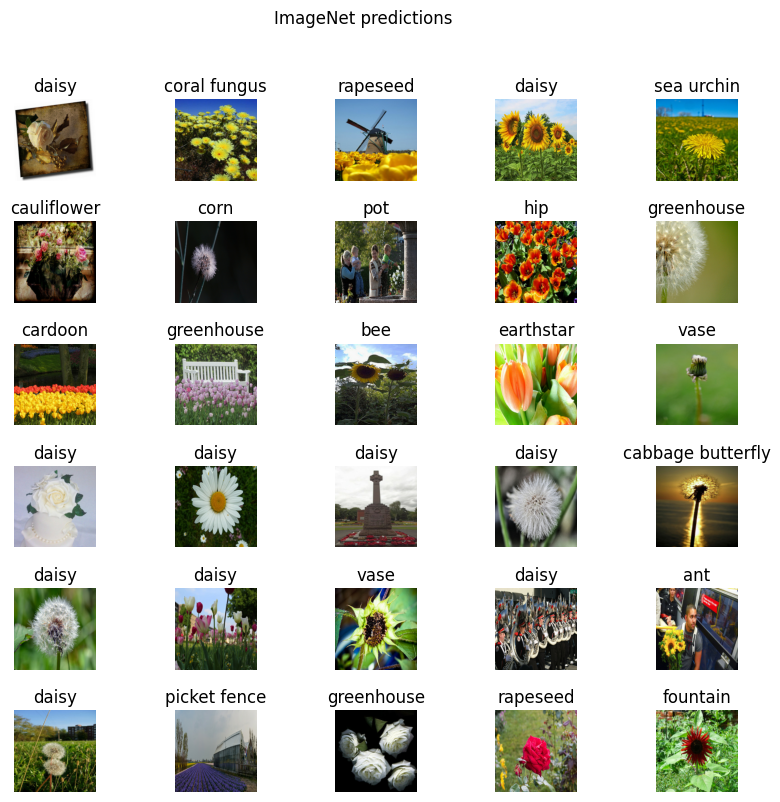

In [34]:
plt.figure(figsize = (10,9))
plt.subplots_adjust(hspace = 0.5)
for i in range(30):

  plt.subplot(6, 5, i+1)

  plt.imshow(image_batch[i])
  plt.title(predicted_class_names[i]) # let's remember that we've took only first 32 images thats why we can simply take first 32 labels from predicted_class_names and it will fit.

  plt.axis(False)

_ = plt.suptitle("ImageNet predictions")

As we can see predictions are pretty bad... We should train our model by using feature extraction.

#### Download headless model

In [35]:
mobilenet_v2 = "https://tfhub.dev/google/tf2-preview/mobilenet_v2/feature_vector/4"
inception_v3 = "https://tfhub.dev/google/tf2-preview/inception_v3/feature_vector/4"

feature_extractor_model = mobilenet_v2

In [36]:
feature_extractor_layer = hub.KerasLayer(
    feature_extractor_model,
    input_shape = IMAGE_SHAPE + (3,),
    trainable = False
)

In [37]:
feature_batch = feature_extractor_layer(image_batch)
feature_batch.shape

TensorShape([32, 1280])

#### Model

Adding fully connected layer for classification

In [38]:
num_classes = len(class_names)

model = tf.keras.Sequential([
    feature_extractor_layer,
    tf.keras.layers.Dense(num_classes)
])

model.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 keras_layer_1 (KerasLayer)  (None, 1280)              2257984   
                                                                 
 dense (Dense)               (None, 5)                 6405      
                                                                 
Total params: 2,264,389
Trainable params: 6,405
Non-trainable params: 2,257,984
_________________________________________________________________


##### Compile

In [39]:
model.compile(
  optimizer=tf.keras.optimizers.Adam(),
  loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True),
  metrics=['acc'])

##### TensorBoard setup

In [40]:
log_dir = 'logs/fit/' + datetime.datetime.now().strftime('%d%m%y-%h%m%s') # creating a log for tensorboard
tensorboard_callback = tf.keras.callbacks.TensorBoard(
    log_dir = log_dir,
    histogram_freq = 1 # Enable histogram computation for every hour
)

##### Fit

In [41]:
NUM_EPOCHS = 10

model.fit(
    train_ds,
    validation_data = val_ds,
    epochs = NUM_EPOCHS,
    callbacks = tensorboard_callback
)

Epoch 1/10
92/92 [==============================] - 11s 78ms/step - loss: 0.8015 - acc: 0.7101 - val_loss: 0.4615 - val_acc: 0.8597
Epoch 2/10
92/92 [==============================] - 6s 69ms/step - loss: 0.3825 - acc: 0.8675 - val_loss: 0.3672 - val_acc: 0.8815
Epoch 3/10
92/92 [==============================] - 6s 65ms/step - loss: 0.2988 - acc: 0.9070 - val_loss: 0.3318 - val_acc: 0.8951
Epoch 4/10
92/92 [==============================] - 6s 65ms/step - loss: 0.2486 - acc: 0.9261 - val_loss: 0.3142 - val_acc: 0.8951
Epoch 5/10
92/92 [==============================] - 6s 66ms/step - loss: 0.2133 - acc: 0.9401 - val_loss: 0.3041 - val_acc: 0.9019
Epoch 6/10
92/92 [==============================] - 6s 65ms/step - loss: 0.1864 - acc: 0.9493 - val_loss: 0.2976 - val_acc: 0.9005
Epoch 7/10
92/92 [==============================] - 6s 67ms/step - loss: 0.1650 - acc: 0.9608 - val_loss: 0.2932 - val_acc: 0.9087
Epoch 8/10
92/92 [==============================] - 6s 67ms/step - loss: 0.1473 - 

#### Predictions

In [42]:
predictions = model.predict(image_batch)
predictions.shape

1/1 [==============================] - 0s 461ms/step


(32, 5)

##### Launch TensorBoard

In [43]:
%load_ext tensorboard

In [44]:
%tensorboard --logdir logs/fit

<IPython.core.display.Javascript object>

##### Check the predictions

In [45]:
predicted_batch = model.predict(image_batch)
predicted_id = tf.math.argmax(predicted_batch, axis = 1)
predicted_label_batch = class_names[predicted_id]
predicted_label_batch

1/1 [==============================] - 0s 31ms/step


array(['roses', 'dandelion', 'tulips', 'sunflowers', 'dandelion', 'roses',
       'dandelion', 'roses', 'tulips', 'dandelion', 'tulips', 'tulips',
       'sunflowers', 'tulips', 'dandelion', 'roses', 'daisy', 'tulips',
       'dandelion', 'dandelion', 'dandelion', 'tulips', 'sunflowers',
       'roses', 'sunflowers', 'dandelion', 'tulips', 'roses', 'roses',
       'sunflowers', 'tulips', 'sunflowers'], dtype='<U10')

##### Plot predictions

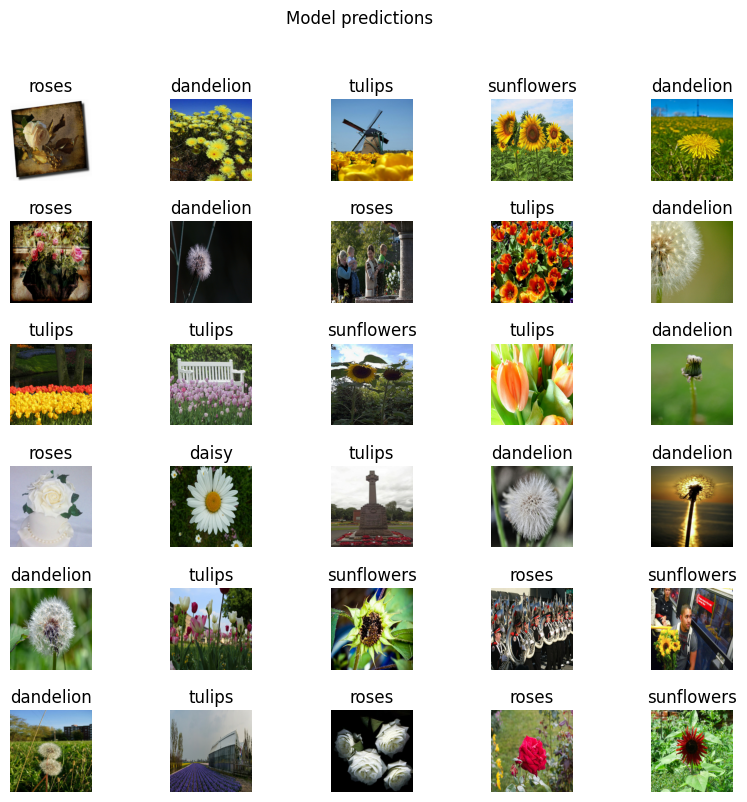

In [46]:
plt.figure(figsize = (10,9))
plt.subplots_adjust(hspace = 0.5)
for i in range(30):

  plt.subplot(6, 5, i+1)

  plt.imshow(image_batch[i])
  plt.title(predicted_label_batch[i])

  plt.axis(False)

_ = plt.suptitle('Model predictions')

#### Export and Reload the model

In [47]:
t = time.time()

export_path = '/tmp/save_model/{}'.format(int(t))
model.save(export_path)

export_path

'/tmp/save_model/1685102046'

Let's now confirm that our model was properly saved

In [48]:
reloaded = tf.keras.models.load_model(export_path)

In [49]:
result_batch = reloaded.predict(image_batch) # results from old model 
reloaded_result_batch = reloaded.predict(image_batch) # results from reloaded model

1/1 [==============================] - 0s 32ms/step


In [50]:
abs(reloaded_result_batch - result_batch).max()

0.0

There is no difference between both models predictions, thus reloaded model was correctly exported and then imported.

In [51]:
reloaded_predicted_id = tf.math.argmax(reloaded_result_batch, axis = 1)
reloaded_predicted_label_batch = class_names[reloaded_predicted_id]
reloaded_predicted_label_batch

array(['roses', 'dandelion', 'tulips', 'sunflowers', 'dandelion', 'roses',
       'dandelion', 'roses', 'tulips', 'dandelion', 'tulips', 'tulips',
       'sunflowers', 'tulips', 'dandelion', 'roses', 'daisy', 'tulips',
       'dandelion', 'dandelion', 'dandelion', 'tulips', 'sunflowers',
       'roses', 'sunflowers', 'dandelion', 'tulips', 'roses', 'roses',
       'sunflowers', 'tulips', 'sunflowers'], dtype='<U10')

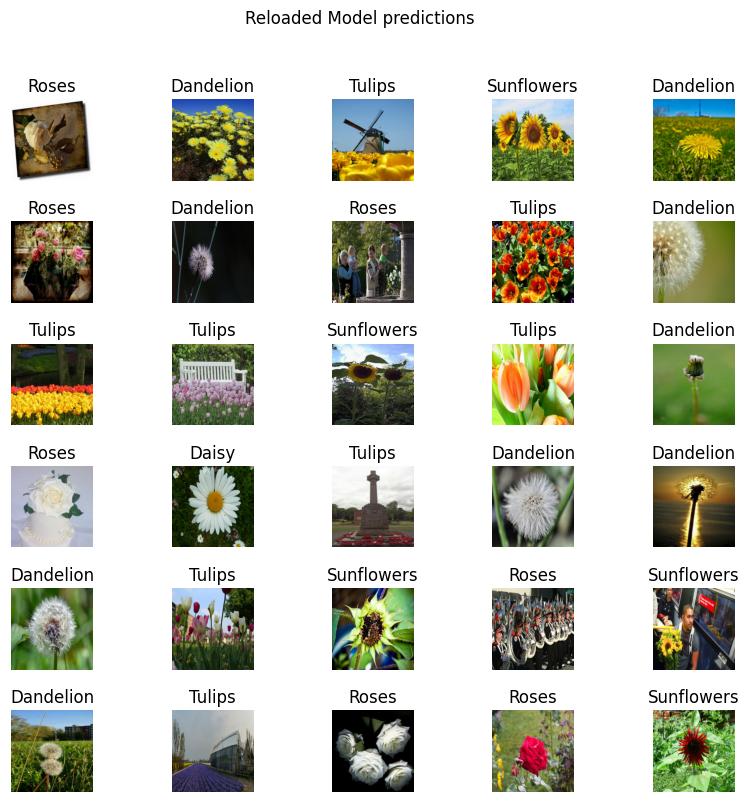

In [52]:
plt.figure(figsize = (10,9))
plt.subplots_adjust(hspace = 0.5)
for i in range(30):
  plt.subplot(6, 5, i+1)
  plt.imshow(image_batch[i])
  plt.title(reloaded_predicted_label_batch[i].title())
  plt.axis('off')
_ = plt.suptitle("Reloaded Model predictions")

### Weights and Biases Intro

In [53]:
pip install wandb

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [54]:
pip install transformers

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [55]:
import wandb
from transformers import DebertaV2ForQuestionAnswering

In [56]:
# Create run here we need paste our key from wandb.com
run = wandb.init(project = 'flowers')